Osnabrück University - Computer Vision (Winter Term 2021/22) - Prof. Dr.-Ing. G. Heidemann, Ulf Krumnack, Axel Schaffland

# Exercise Sheet 8: Recognition 

## Introduction

This week's sheet should be solved and handed in before the end of **Tuesday, January 18, 2022**. If you need help (and Google and other resources were not enough), feel free to contact your groups' designated tutor or whomever of us you run into first. Please upload your results to your group's Stud.IP folder.

## Exercise 0: Math recap (Covariance) [0 Points]

This exercise is supposed to be very easy, does not give any points, and is voluntary. There will be a similar exercise on every sheet. It is intended to revise some basic mathematical notions that are assumed throughout this class and to allow you to check if you are comfortable with them. Usually you should have no problem to answer these questions offhand, but if you feel unsure, this is a good time to look them up again. You are always welcome to discuss questions with the tutors or in the practice session. Also, if you have a (math) topic you would like to recap, please let us know.

**a)** What does *covariance* express?

YOUR ANSWER HERE

**b)** Provide a formula to compute the covariance of two 1-dimensional datasets. How can it be generalized to the $n$-dimensional case?

YOUR ANSWER HERE

**c)** Create and plot two (1-dimensional) datasets with low covariance (use `plt.scatter`). Then do the same for two datasets with high covariance.

In [ ]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

# YOUR CODE HERE

## Exercise 1: Template Matching Theory [2 points]

**a)** Explain in your own words the idea of *template matching*. Is it a data or model based approach? What are the advantages and disadvantages? In what situations would you apply template matching?

Template matching is used to detect certain structures in pictures. A certain image which is simplifiying the original image, more precisely the structure to detect, is a template moved over the picture row for row. However, no convolution is computed, rather the similartiy between image and template is computed producing a similarity map. It is a data based approach. The approach is not robust against scaling gray values. You would apply template matching if you want to detect simple structures very fast. 

**b)** Explain the ideas of *mean absolute difference* and *correlation coefficient*. Name pros and cons.

Both the mean absolute difference and the correlation coefficient are used in template matching and aim to provide a way to find the part of the image that most closely resembles the template, so they are both similarity measures. The idea of the mean absolute difference is to compute the mean difference of the gray values. The approach depends on shape and on absolute gray values. It is advantageous that it is robust against rotation and noise.
The Correlation coefficient is only depending on shape which is ideal. But to use this technique it is necessary that the template be normalized to have a mean of 0, so that the correlation can be computed using convolution.For large images the Fourier transform can be used to speed up the convolution.



## Exercise 2: Template Matching Practice: Where is Waldo [2 points]

In the two images `wheresWaldo1.jpg` and `wheresWaldo2.jpg`, Waldo is hiding in the midst of a busy crowd. He always wears the same red and white striped sweater and hat. However, he may be carrying a something that varies from scene to scene. Use template matching with the given Waldo templates (`waldo*.jpg`) to locate Waldo. Highlight
Waldo in the scene and indicate which template was matched.

**Hints:**
* You may use buildin functions to solve this exercise. E.g `skimage.feature.match_template` or `cv2.matchTemplate`
* The images are quite large! You may start by testing your code on a small image patch before applying it to the full scene.
* You may not achieve a perfect match. Analyse the problems you encounter and think how you can improve your result.

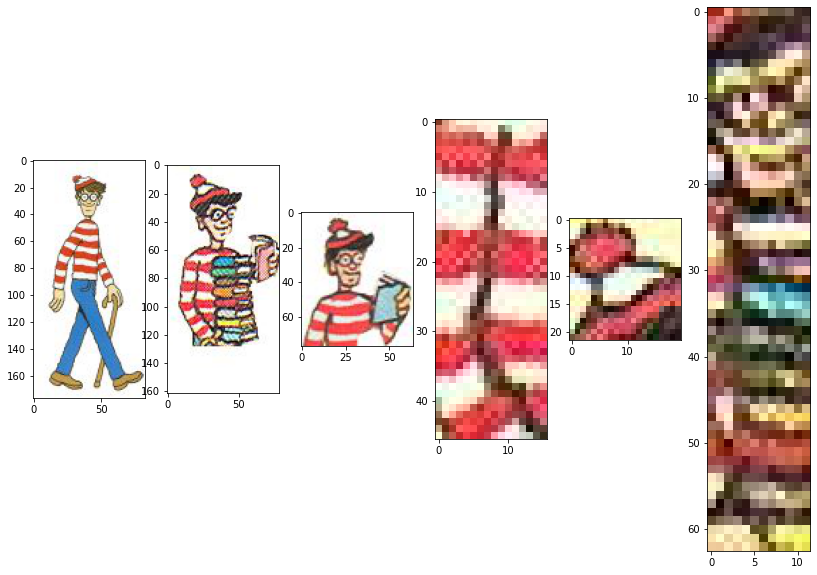

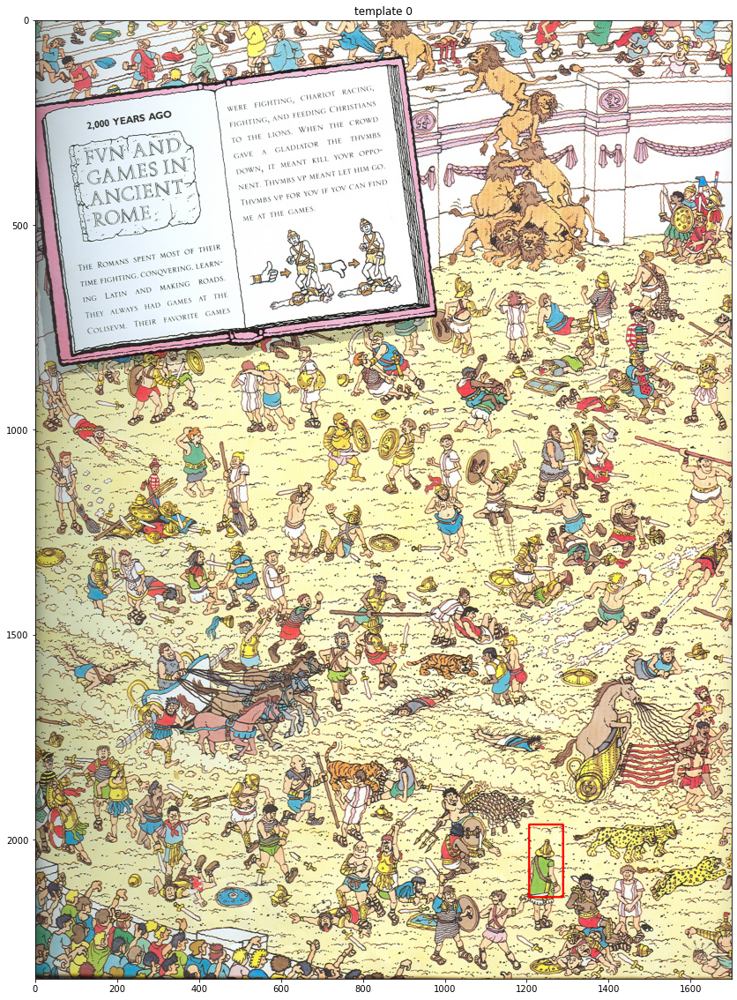

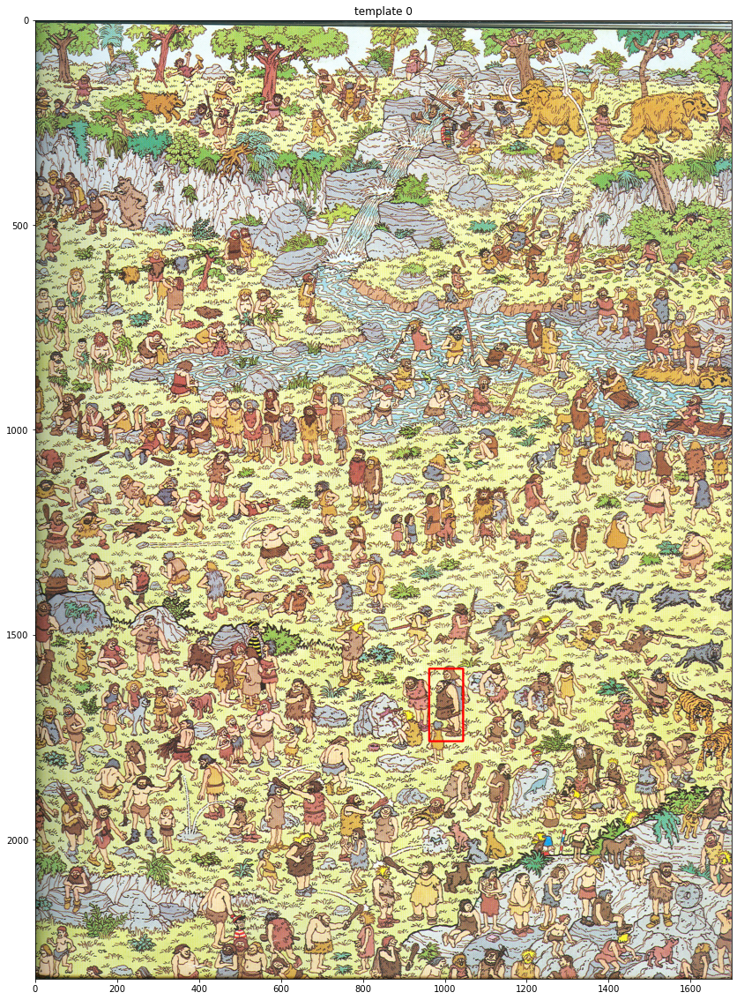

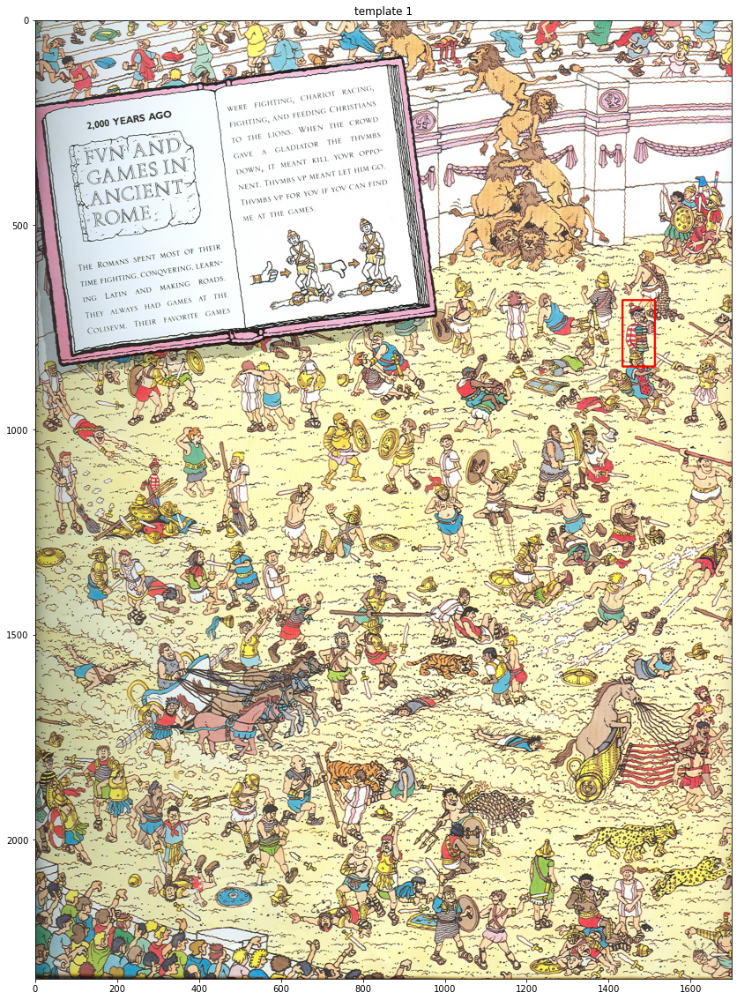

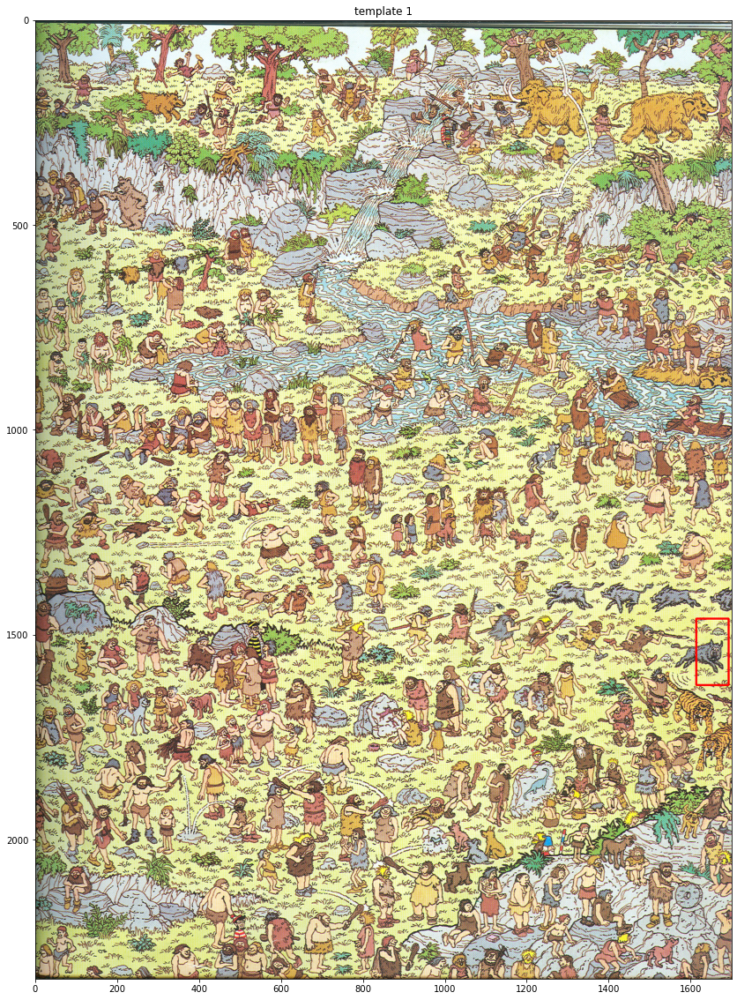

...

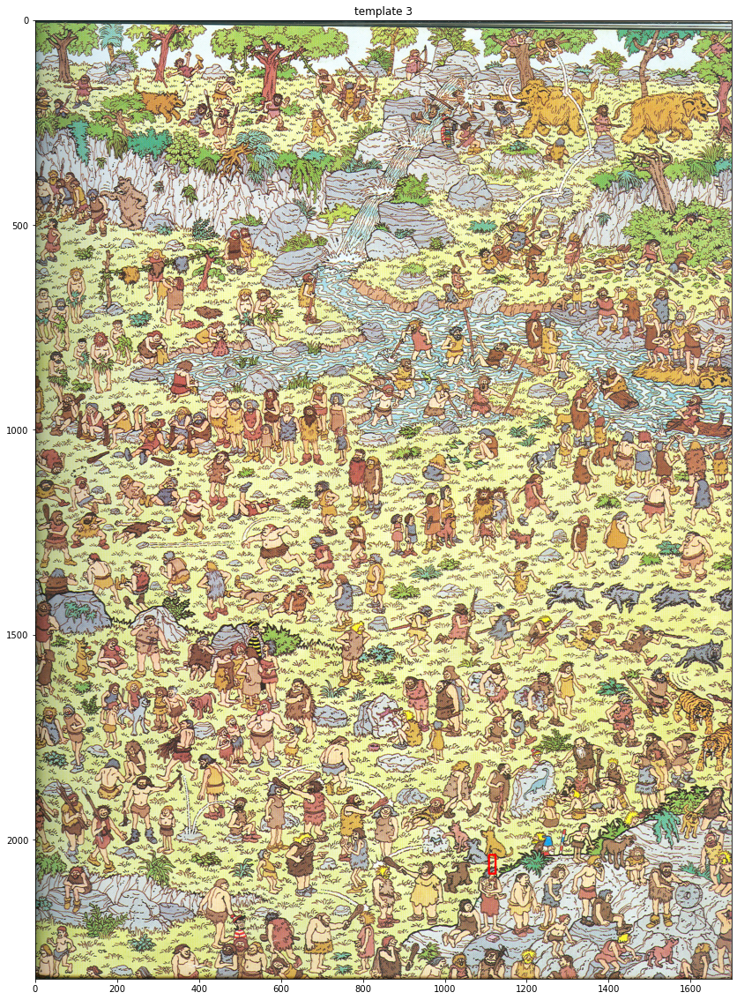

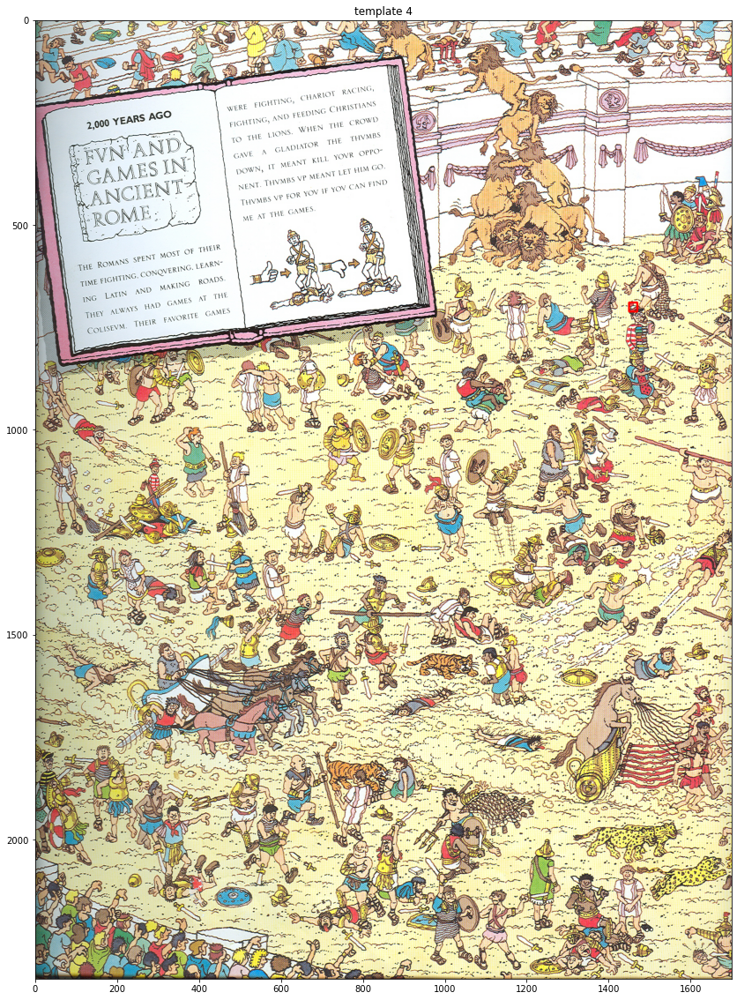

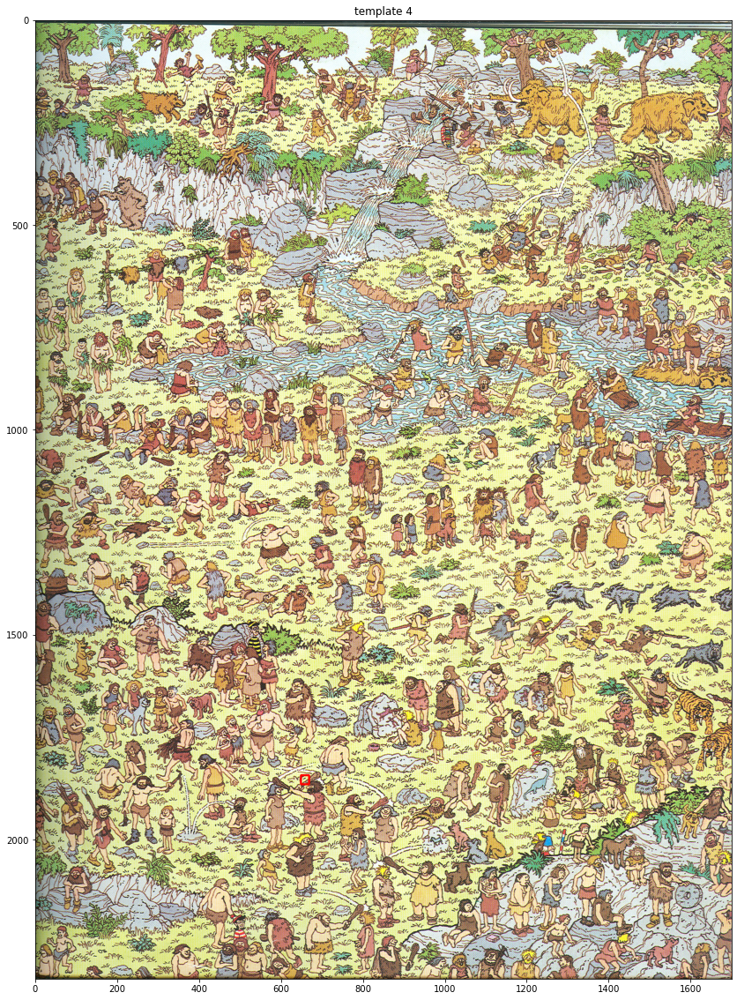

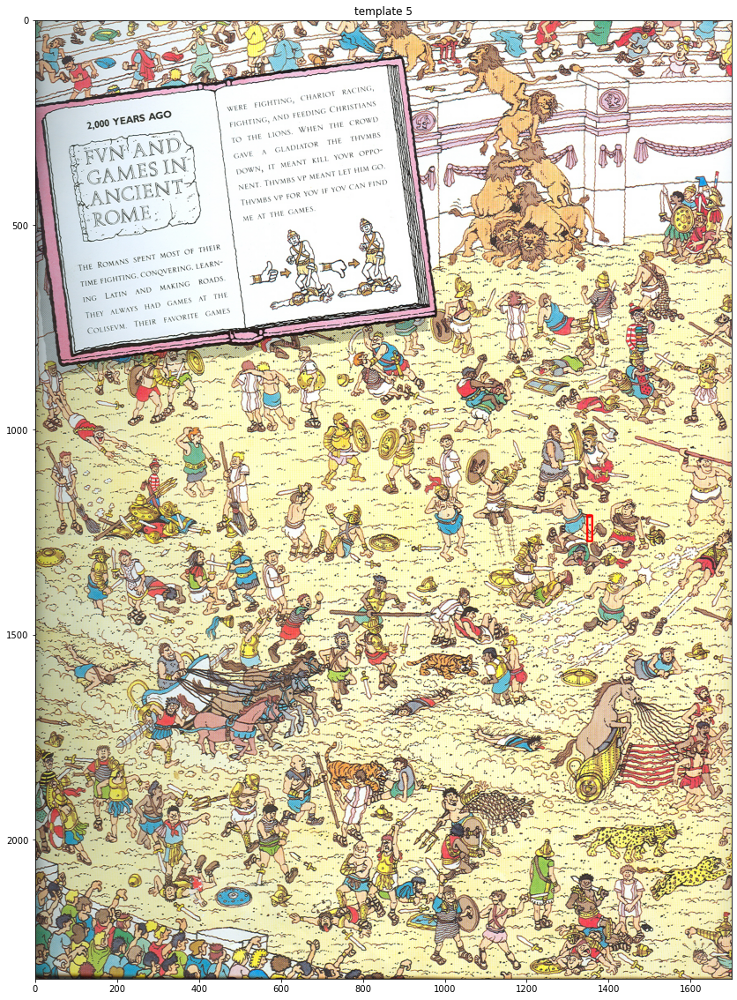

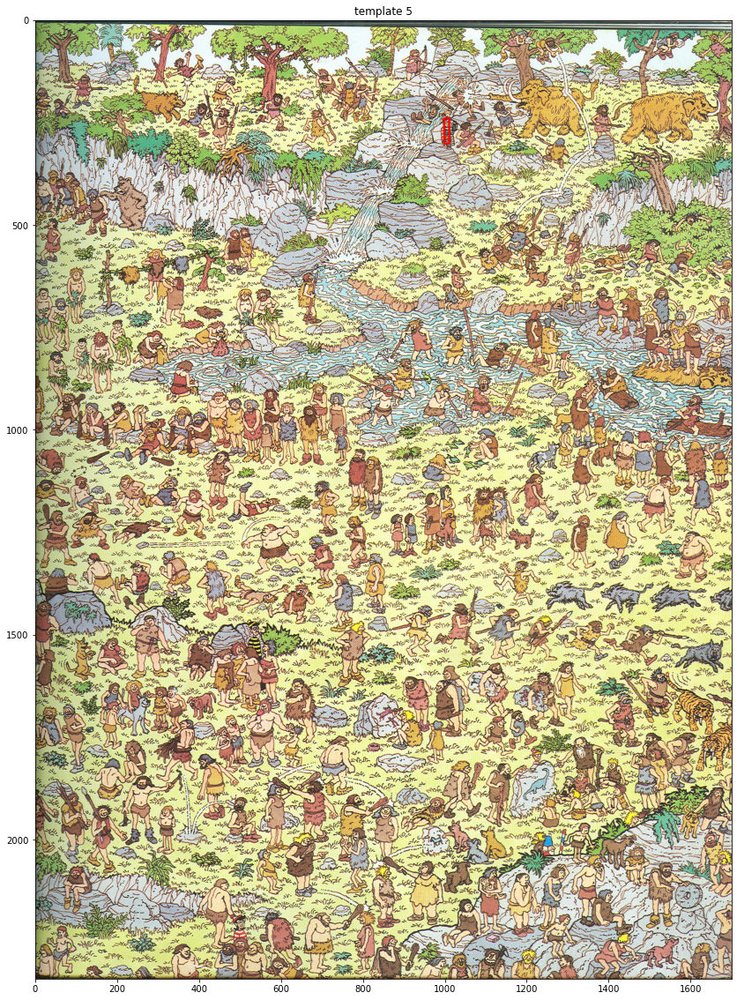

In [21]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import cv2 
from skimage import feature

# skimage.feature.match_template or cv2.matchTemplate
waldos = [plt.imread('images/waldo/wheresWaldo{}.jpg'.format(i)) for i in range(1, 3)]
templates = [plt.imread('images/waldo/waldo{}.jpg'.format(i)) for i in range(0, 6)]
    
plt.figure(figsize = (14, 10))
for i,img in enumerate(templates):
    plt.subplot(1,len(templates),i+1)
    plt.imshow(img) 
    
    
# YOUR CODE HERE --------------------------------------------------------------------------------------------------


for j in range(0,6): 
    for i in range(1,3):
        
        # initialize pictures
        waldo = plt.imread('images/waldo/wheresWaldo{}.jpg'.format(i))
        template = plt.imread('images/waldo/Waldo{}.jpg'.format(j))
        
        # convert both the image and template to grayscale
        imageGray = cv2.cvtColor(waldo, cv2.COLOR_BGR2GRAY)
        templateGray = cv2.cvtColor(template, cv2.COLOR_BGR2GRAY)

        # perform template matching
        result = cv2.matchTemplate(imageGray, templateGray,cv2.TM_CCOEFF_NORMED)
        (minVal, maxVal, minLoc, maxLoc) = cv2.minMaxLoc(result)

        # determine the starting and ending (x, y)-coordinates of the bounding box
        (startX, startY) = maxLoc
        endX = startX + template.shape[1]
        endY = startY + template.shape[0]

        # draw the bounding box on the image
        cv2.rectangle(waldo, (startX, startY), (endX, endY), (255, 0, 0), 3)

        # show the output image
        plt.figure(figsize = (20, 20))
        plt.title("template {}".format(j))
        plt.imshow(waldo)

# YOUR CODE HERE --------------------------------------------------------------------------------------------------


# how to improve the result? 
# --> better select template? distinguish result picture into several pictures? 

## Exercise 3: Pattern Recognition and PCA [4 points]

**a)** What are the goals of *pattern recognition*? How can they be achieved? What are the problems?

Pattern recogniton aims to convert signals to symbols. There are certain steps related to pattern recogniton such as feature extraction and classification. The features are meant to be extracted in a way such that it supports the classification task. Additionally, more important than a good classifier are good features such as fulfilling requirements of discrimation, reduced redundancy and robustness concerning significant changes of the signal. Mapping the signals to symbols can be quite complex. Indicators like distance, robustness, variation and abstraction are directly connected to the complexity of conversion. Generally, mapping the signal to symbols is the more difficult the less similar the “neighborhoods” of signals are to those of the symbols. Problems arise if those critera are not fulfilled properly, it is getting more complex.

**b)** What is *principal component analysis*? How is it related to pattern recognition?

By and large, the idea of PCA is simple — reduce the number of variables of a data set, while preserving as much information as possible. It is a dimensionality-reduction method that is often used to reduce the dimensionality of large data sets, by transforming a large set of variables into a smaller one that still contains most of the information in the large set.

**c)** Explain how principal components can be computed? Then implement a function that performs the computation.

Each column in the Eigen vector-matrix corresponds to a principal component.

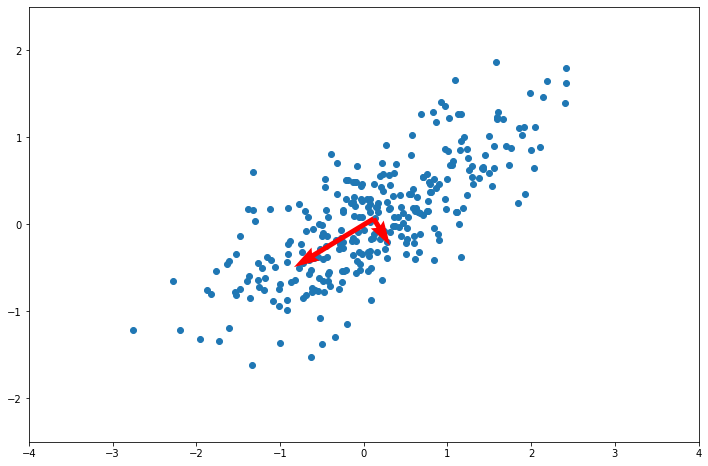

In [136]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np


def pca(data):
    """
    Perform principal component analysis.
    
    Args:
        data (ndarray): an array of shape (n,k),
        meaning n entries with k dimensions
        
    Returns: two arrays
        pc (ndarray): array of shape (k,k) holding the principal components in its columns.
        var (ndarray): k-vector holding the corresponding variances, in descending order.
    """
    
    # Replace the following two lines by your code ...
    pc = np.random.randn(data.shape[1],data.shape[1])
    var = np.random.rand(data.shape[1])
    
    # YOUR CODE HERE ----------------------------------------------------------------------------------------------
    
    # Substract mean of each variable
    #data_meaned = data - np.mean(data , axis = 0)
    
    # Calculate covariance matrix 
    cov_mat = np.cov(data , rowvar = False)
     
    # Compute Eigenvalues
    eigen_values , eigen_vectors = np.linalg.eigh(cov_mat)
     
    # Sort in descending order
    sorted_index = np.argsort(eigen_values)[::-1]
    sorted_eigenvalue = eigen_values[sorted_index]
    sorted_eigenvectors = eigen_vectors[:,sorted_index]
     
    # Select subset of Eigenvectors
    num_components = 2
    eigenvector_subset = sorted_eigenvectors[:,0:num_components]
     
    # Transform data 
    data_reduced = np.dot(eigenvector_subset.transpose() , data.transpose() ).transpose()
    
    
    pc = sorted_eigenvectors
    var = sorted_eigenvalue

    # YOUR CODE HERE ----------------------------------------------------------------------------------------------
    
    return pc, var

# generate some random data
np.random.seed(23)
data = np.random.multivariate_normal([0,0], cov = [[1, .55], [.55, .5]], size=300)

# compute the principal components
pc, var = pca(data)
mean = data.mean(axis=0)

# plot the results
plt.figure(figsize=(12,8))
plt.xlim(-4,4)
plt.ylim(-2.5,2.5)
plt.scatter(*data.T)
plt.quiver(*mean[np.newaxis].repeat(2,axis=0).T, *(np.sqrt(var)*pc), color='red', scale=1, scale_units='xy')
plt.show()

# sanity check
assert np.allclose(var, [1.216, 0.137], rtol=1e-3)

## Exercise 4: Eigenfaces [6 points]

**a)** Import the images from the directory `images/trainimgs` into an numpy array using the function 
`read_images_from_directory` provided in the cell below. Display the images and the corresponding names.

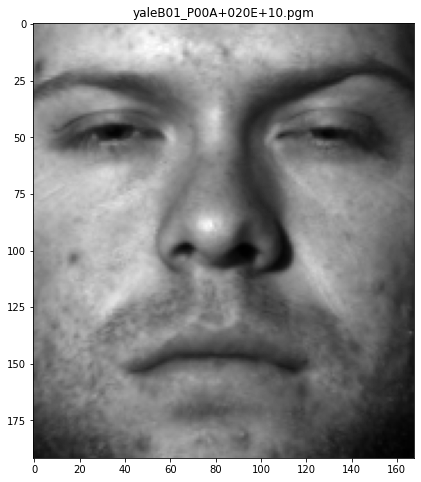

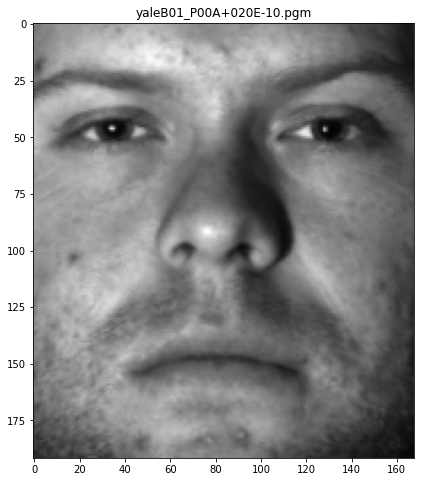

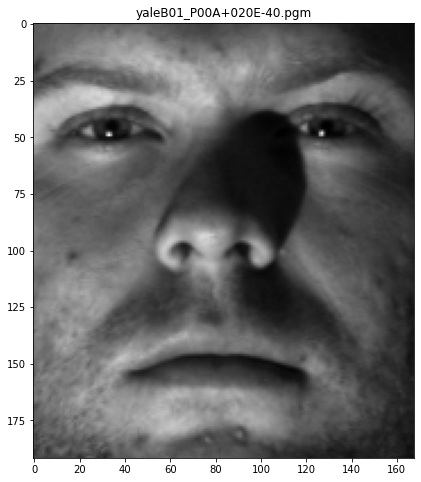

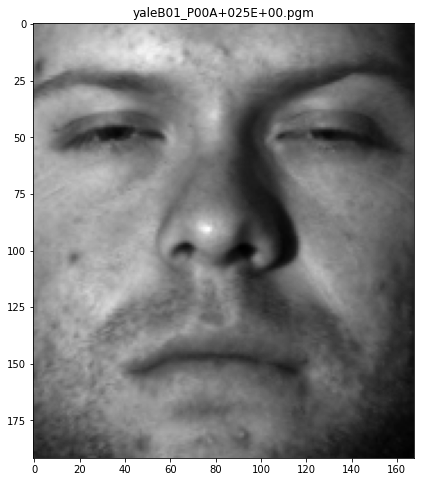

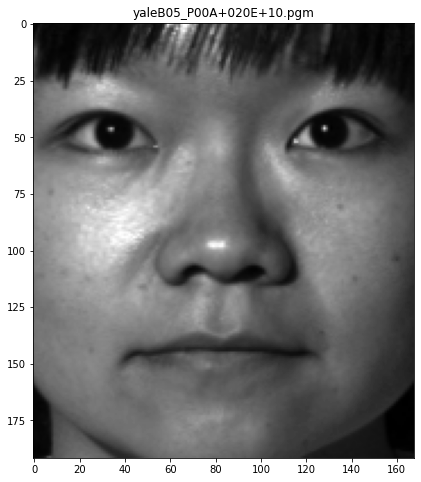

...

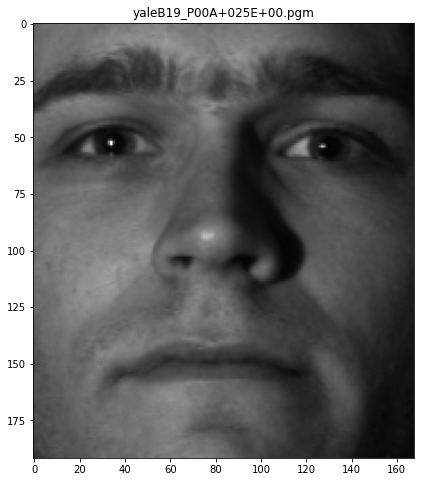

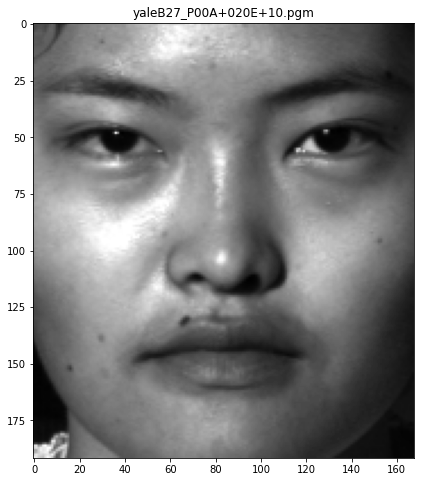

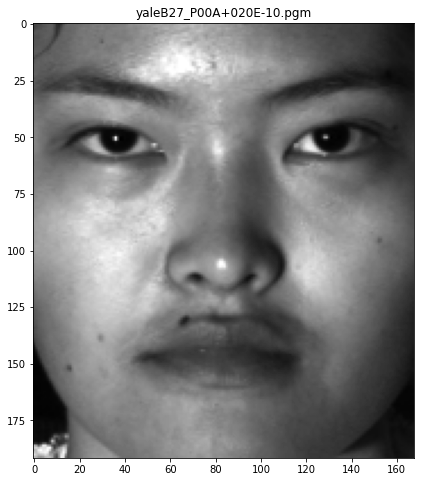

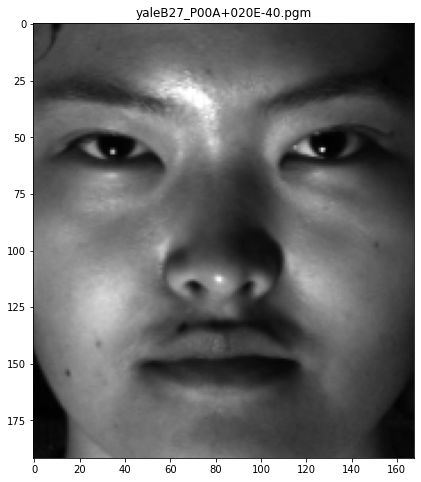

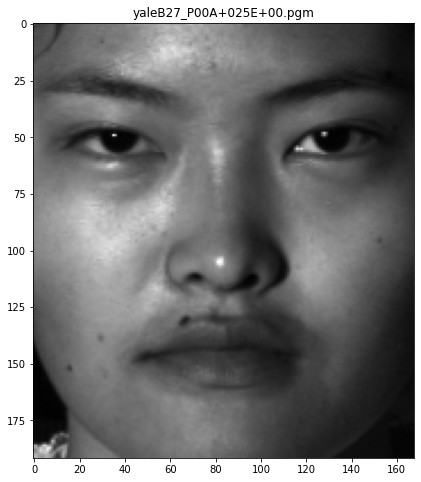

In [143]:
%matplotlib inline
import sys
import os
import glob
import numpy as np
import matplotlib.pyplot as plt

def read_images_from_directory(directory, suffix, shape):
    """
    Read all images found in DIRECTORY with given file
    name SUFFIX. All images should have the same SHAPE,
    specified as (rows,columns).
    
    Args:
        directory (string): Name of input directory.
        suffix (string): File type suffix.
        shape (tuple): Shape of images to be loaded.
    
    Returns:
        images (ndarray): A numpy array of shape m*rows*columns (from shape)
        names (list): A list of corresponding image names.
    """

    # initialize the image array and name list
    #images = np.empty((0, *shape))
    images = np.empty((0, ) + shape)
    names = []

    # now loop through all image files in the directory
    for file_name in glob.glob(directory + os.sep + '*.' + suffix):
        if os.path.isfile(file_name):

            # load each image (as double)
            img = plt.imread(file_name)

            # check for correct size
            if img.shape == shape:
                images = np.append(images, img.reshape((1, ) + shape), axis=0)
                names.append(os.path.basename(file_name))
            else:
                print(
                    'warning: Image "' + file_name +
                    '" with wrong size will be ignored!',
                    file=sys.stderr)

    return images, names


# image file suffix
suffix = 'pgm'

# image size
img_shape = (192, 168)

# directory 
directory = "images/trainimg"

# YOUR CODE HERE

images, names = read_images_from_directory(directory, suffix, img_shape)

for image, name in zip(images, names): 
    plt.figure(figsize=(12,8))
    plt.imshow(image)
    plt.title(name)

**b)** Use PCA to compute the eigenfaces (i.e. the eigenvectors of the face images). You may use your PCA function from Exercise 1c or some build in function. Explain what kind of input PCA expects, and how that fits to our images (you may have to `reshape` the images!). Finally, display the eigenfaces.

(2, 322560)


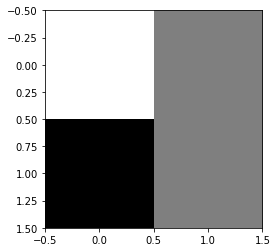

In [149]:
# YOUR CODE HERE
from sklearn.decomposition import PCA
import pandas
#645.120
images = images.reshape(2, 322560)
print(images.shape)
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(images)

plt.imshow(principalComponents)



**c)** Now project the training face images into the eigenspace to calculate their ”feature vectors”,
i.e. a representation with significantly lower dimension. For the projection of the face images,
they have to be centered first, i.e. the mean face vector has to be subtracted. Store the mean face in some vector (`mean_face`) and the representation achieved in some array (`face_db`). Finally restore the images from `face_db` and display them alongside the original image. Try out the effect of changing the number of eigenfaces to be used (`num_eigenfaces`).

In [ ]:
# number of eigenfaces to be used
num_eigenfaces = 19

# Remark: a value of 20 (theoretical perfect reconstruction) may suffer from numerical
# instability (the last eigenface may introduce noise).
# However, a value of 19 suffices for almost perfect reconstruction ...

# YOUR CODE HERE

**d)** Understand the function `recognize_face` that recognizes a face from that database by calculating the euclidean distance of this face feature vector to all of the training feature vectors from the database. The feature vector with the smallest distance represents the winner category. Check the implementation by recognizing the images from the training set (they should be recognized without error).

In [ ]:
from scipy.spatial.distance import cdist

def recognize_face(face, eigenfaces, mean_face, face_db):
    """
    Recognize a face from a face database.
    and return the index of the best matching database entry.

    The FACE is first centered and projected into the eigeface
    space provided by EIGENFACES. Then the best match is found
    according to the euclidean distance in the eigenface space.
    
    Args:
        face (ndarray): Face to be recognised.
        eigenfaces (ndarray): Array of eigenfaces.
        mean_face (ndarray): Average face.
        face_db (ndarray): Database of faces projectected into Eigenface space.
        
    Returns:
        index (uint): Position of the best matching face in face_db.
    """
    index = -1


    # center the face
    centered = face - mean_face

    # and project it into the eigenface space
    projected = eigenfaces @ centered

    # Now compute the similarity to all known faces
    # (comparison is performed in the eigenface space)
    distances = cdist(face_db, projected[None, :])
    index = distances.argmin()



    return index


# ... and now check the function on the training set ...
def show_recognition_results(imgs, labels, train_imgs, train_labels,
                             num_eigenfaces, eigenfaces, mean_face, face_db):
    """Iterate over all face images and compute the best matching face in face_db.
    
    Args:
        imgs (list): List of test faces.
        train_imgs (list): List of training faces.
        train_labels (list): List of training labels.
        num_eigenfaces (uint): Number of eigenfaces.
        eigenfaces (list): List of the eigenfaces.
        mean_face (ndarray): Average face.
        face_db (ndarray): Database of faces projectected into Eigenface space.
        
    Returns:
    
    """
    
    img_shape = imgs[0].shape
    plt.figure(figsize=(12, 12))
    plt.suptitle(
        'Face recognition based on {} principal components'.format(num_eigenfaces))
    plt.gray()
    for j, img in enumerate(imgs):

        # find the best match in the eigenface database
        winner = recognize_face(
            img.reshape(np.prod(img_shape)), eigenfaces, mean_face, face_db)
        name_label = labels[j][5:7]
        name_winner = train_labels[winner][5:7]

        plt.subplot(5, 8, 2 * j + 1)
        plt.axis('off')
        plt.imshow(img)
        plt.title(labels[j][5:7])

        plt.subplot(5, 8, 2 * j + 2)
        plt.axis('off')
        plt.imshow(train_imgs[winner])
        t = plt.title(('*' if name_label != name_winner else '') + name_winner)
        plt.setp(t, color='r' if name_label != name_winner else 'g') 
    plt.show()
    
show_recognition_results(train_imgs, train_names,
                         train_imgs, train_names,
                         num_eigenfaces, eigenfaces_used, 
                         mean_face, face_db)


**e)** Now classify the images in directory `images/testimg/`. Try to reduce the number of principal components
used. How many PCs are necessary to still achieve perfect classification?

In [ ]:
test_imgs, test_names = read_images_from_directory('images/testimg', suffix,
                                                   img_shape)

# YOUR CODE HERE

## Exercise 5: Understanding the Wireframe-Model [5 points]

This exercise addresses the matching procedure described on (CV-12 Model Based Recognition slides 9-17)

**a)** Explain in your own words the functions on slide  (CV-12 slide 9). Also explain when and why it may make sense to use $m$ instead of $m'$.


The gradient magnitude m and orientation β for the image g(x,y) is computed.

1. x-gradient ∆xg = g(x+1,y) − g(x−1,y) 
2. y-gradient ∆yg = g(x,y+1) − g(x,y−1) --> take difference between pixel above and below 
3. gradient magnitude m ́(x,y) = (∆xg^2 + ∆yg^2 )1/2 --> 
4. orientation ß β(x,y) = arctan(∆yg / ∆xg) --> take inverse tangent (!division of 0 and 

Alternative formula for gradient magnitude: 
gradient is thresholded 
m(x,y) = Θ(m ́(x,y) − T) --> only use fitness scores for magnitudes which are abovve a certain threshold. Would give magnitude where real magnitude m prime is suffiently large 

We want to threshold the magnitude in order to find edge points



**b)** Explain the fitness score $E_{si}$ and $E_l$. What do the arrows (CV-12 slide 11), e.g. $\beta_j$ and $S_j$, indicate? What is the idea of $G(d)$?

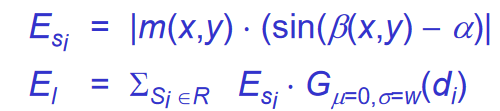

Esi:
--> contributes to one pixel 
El :
--> contributes to line segment 

Fitness must be proportional to gradient magnitude. Judge quantities. Beta(gradient direction), alpha(direction of line) taking their difference (if 0 as bad as can be) (perfect is 90 degrees)  of Esi 

El: the Esis must be summed up to a total contribution. Take sum over all Si. weight this by gaussian distance function. Because We want that pixels are along the line segment and these belong to edge.


We want to know if this line segment is well located on an edge.

**c)** Explain the goal of EDA (Estimation of Distribution Algorithm) and how it is performed in the context of the matching procedure.

Goal: optimization algorithm. evolutionary computation. next generation of individuals is sampled from the
distribution estimated from selected individuals of the previous generation.

Generation of individuals. Starting with several wire frame models. Each individual is point in 15D parameter space. Starting with a so called cloud which is not arbitrary but contributes to the inital estimates concerning pose and position. Next generation will be sampled from distribution with random process new individuals will be produced. We need selection. Choose individuals with highest fitness score. Those are meant to be for next generation (to reproduce). 

How to produce? density estimation of remaining point cloud is done by gaussian function. use density function as a biased random  number generation to produce points. Likely that offspring are similar to parents- give bias but does not perfectly conform to that. 

Next generation again be projected into the plane compute fitness scores along the line segments and edges, sort out bad individuals and good ones are allowed to produce. 


## Exercise 6: Histogram of Oriented Gradients (HOG) [3 points]

The *Histogram of Oriented Gradients (HOG)* applied in the initial step of the wireframe matching procedure is also applied in other computer vision algorithms, especially in the context of object recognition. This exercise will examine this tool in a bit more detail.

**a)** Explain the idea of the histogram of oriented gradients. How can it be applied to analyze images? Think how this idea may be used to recognize objects?

feature descriptor  counts occurrences of gradient orientation in the localized portion of an image. This method is quite similar to Edge Orientation Histograms and Scale Invariant aFeature Transformation (SIFT). The HOG descriptor focuses on the structure or the shape of an object. It is better than any edge descriptor as it uses magnitude as well as angle of the gradient to compute the features. For the regions of the image it generates histograms using the magnitude and orientations of the gradient

he principle behind the histogram of oriented gradients descriptor is that local object appearance and shape within an image can be described by the distribution of intensity gradients or edge directions. The x and y derivatives of an image (Gradients) are useful because the magnitude of gradients is large around edges and corners due to abrupt change in intensity and we know that edges and corners pack in a lot more information about object shape than flat regions. So, the histograms of directions of gradients are used as features in this descriptor

Part of the idea of HOG is already obvious from the name, it takes the histogram of the gradient orientations, so it counts the occurences of the angles of the gradients which are weighted by the respective gradient magnitude, but importantly this is (usually) not done for the whole image but individually for small sections, called cells, of the image so that the result consists of many histograms - one for each image cell.
From this one can then easily extract the most prominent gradient direction for each cell, which might be useful in determining an objects orientation. Conventionally, one may also call HOG a feature descriptior because it focuses on the sturcture or shape of an object whereas it is using magnitude and angle of the gradient to compute the features.



**b)** The Scikit-image library provides the function [`hog`](https://scikit-image.org/docs/dev/auto_examples/features_detection/plot_hog.html) that can compute histograms of oriented gradients and offers also an option to construct a visualization. Run the following code cell and then describe your observations in the text cell below:

<IPython.core.display.Javascript object>


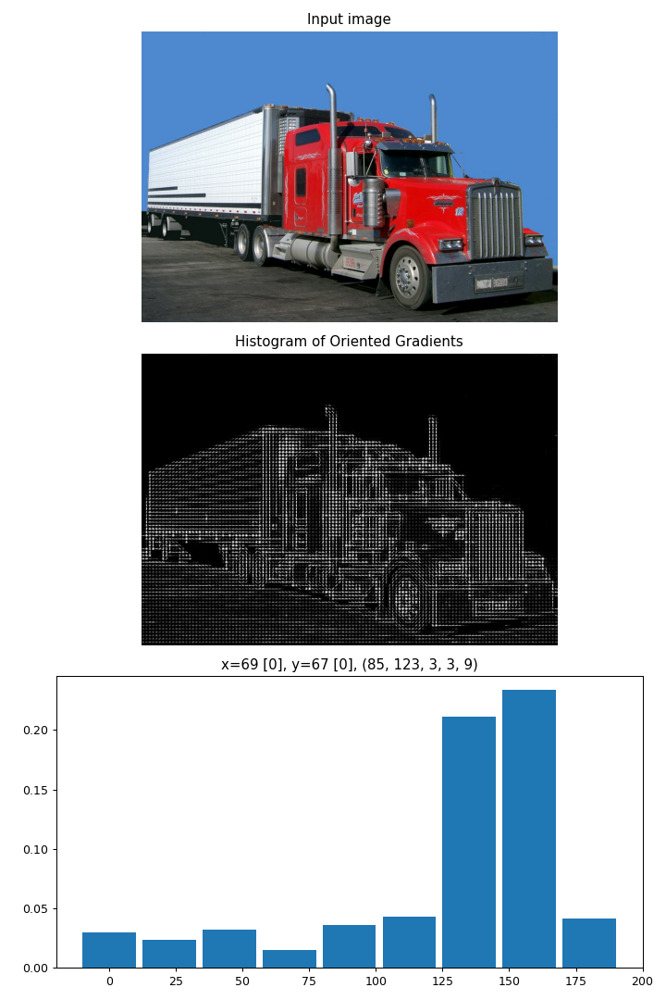

In [64]:
%matplotlib notebook

import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import data, exposure
from skimage.transform import resize
import numpy as np
import imageio

image = imageio.imread('./images/truck.jpeg')
image = resize(image,(700,1000),preserve_range=True).astype(np.uint8)

fd, hog_image = hog(image,feature_vector=False,visualize=True, multichannel=True)
#multichannel is depcricated starting from skimage 0.19.0, use channel_axis instead
#fd, hog_image = hog(image,feature_vector=False,visualize=True, channel_axis=2)

# Display the result
fig, (ax1, ax2, ax3) = plt.subplots(3,1, figsize=(8, 12))

ax1.axis('off')
ax1.imshow(image, cmap=plt.cm.gray)
ax1.set_title('Input image')

# Rescale histogram for better display
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

ax2.axis('off')
ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
ax2.set_title('Histogram of Oriented Gradients')
plt.show()

bars = ax3.bar(np.linspace(0,180,fd.shape[-1]),fd[0,0,0,0],width=(180/fd.shape[-1]))

plt.tight_layout()
plt.show()

def on_press(event):
    """Mouse button press event handler
    Args:
    event: The mouse event
    """
    x, y = int(event.xdata)//8, int(event.ydata)//8
    
    cell_x = x - fd.shape[1] if x >= fd.shape[1] else 0
    x = min(x,fd.shape[1]-1)
    cell_y = y - fd.shape[0] if y >= fd.shape[0] else 0
    y = min(y,fd.shape[0]-1)
    ax3.clear()
    ax3.set_title(f"x={x} [{cell_x}], y={y} [{cell_y}], {fd.shape}")
    ax3.bar(np.linspace(0,180,fd.shape[-1]),fd[y,x,cell_y,cell_x],width=(180/fd.shape[-1]))
    fig.canvas.draw()

cid = fig.canvas.mpl_connect('button_press_event', on_press)

YOUR ANSWER HERE

**c)** Implement your own version of the histogram of oriented gradients function. You may proceed in the following steps:
1. Compute the gradient image and determine magnitude and direction of gradients.
2. Divide the image into cells and compute a weighted histogram for each cell.
3. Use the function to [`plt.quiver`](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.quiver.html) to display your results (already implemented).

C:\Users\lisag\AppData\Local\Temp/ipykernel_33756/1877342852.py:27: RuntimeWarning: divide by zero encountered in true_divide
  direction = np.arctan(y_gradient/x_gradient)
C:\Users\lisag\AppData\Local\Temp/ipykernel_33756/1877342852.py:27: RuntimeWarning: invalid value encountered in true_divide
  direction = np.arctan(y_gradient/x_gradient)


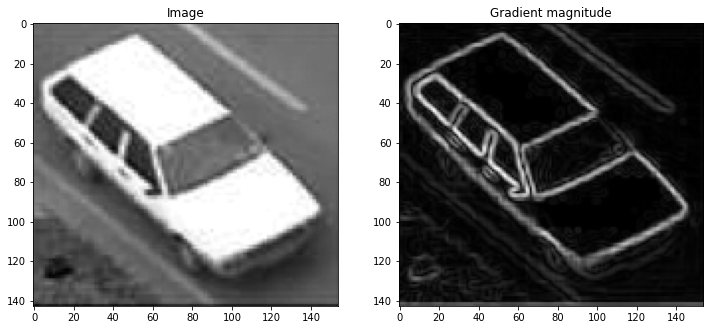

In [72]:
# Step 1: compute gradients

%matplotlib inline
import numpy as np
import imageio
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from scipy.ndimage import sobel


def image_gradients(image):
    """Compute graident magnitudes and directions for a given image.
    
    Input:
        image: an numpy.ndarray of shape (HEIGHT, WIDTH)
    Result:
        magnitude, direction: two numpy.ndarrays of the same shape as image,
        holding gradient magnitudes and directions, respectively.
    """
    # Hint: you may ues the sobel function to obtain x- and y- gradients
    magnitude = np.zeros_like(image, dtype=np.float32)
    direction = np.zeros_like(image, dtype=np.float32)
    
    # YOUR CODE HERE ----------------------------------------------------------------------------------------------
    
    x_gradient = sobel(image, 0)  # horizontal derivative
    y_gradient = sobel(image, 1)  # vertical derivative
    magnitude = np.hypot(x_gradient, y_gradient)
    direction = np.arctan(y_gradient/x_gradient)
    
    # YOUR CODE HERE ----------------------------------------------------------------------------------------------
    
    return magnitude, direction

image = rgb2gray(imageio.imread('./images/car.png').astype(np.uint8))
magnitude, direction = image_gradients(image)

plt.figure(figsize=(12,6))
plt.gray()
plt.subplot(1,2,1); plt.title("Image")
plt.imshow(image)
plt.subplot(1,2,2); plt.title("Gradient magnitude")
plt.imshow(magnitude)
plt.show()

In [133]:
# Step 2: compute the histograms

def histogram_of_oriented_gradients(image, cell_size=(16,16), bins=9):
    """Compute histograms of oriented gradients for an image.
    Input:
        image: image: an numpy.ndarray of shape (HEIGHT, WIDTH)
        cell_size: the size of individual cells into which the image is divided
        bins: the number of bins per histogram
    Result:
        An np.ndarray of shape (CELL_ROWS, CELL_COLUMNS, BINS) containing
        the histograms for the individual cells
    """
    # Hint: you may use np.histogram() here
    rows, columns = image.shape[0]//cell_size[0], image.shape[1]//cell_size[1]
    hog = np.zeros((rows, columns, bins))
    print(hog.shape)
    magnitude, direction = image_gradients(image)
    
    # YOUR CODE HERE ----------------------------------------------------------------------------------------------
    
    # 8 9 9 shape
    new = []
    hog = np.histogram(image, bins = 9)
    rows = np.arange(rows)
    columns = np.arange(columns)
    
    new.append(rows)
    new.append(columns)
    new = np.asarray(new)
    print(new.shape)
    new = new.reshape((8,9))
    
    hog = np.asarray(hog)
    hog = hog.reshape((2,1))
    print(hog.shape)
    
    
    # YOUR CODE HERE ----------------------------------------------------------------------------------------------
    
    
    return hog

hog = histogram_of_oriented_gradients(image)


(8, 9, 9)
(2,)


C:\Users\lisag\AppData\Local\Temp/ipykernel_33756/1877342852.py:27: RuntimeWarning: divide by zero encountered in true_divide
  direction = np.arctan(y_gradient/x_gradient)
C:\Users\lisag\AppData\Local\Temp/ipykernel_33756/1877342852.py:27: RuntimeWarning: invalid value encountered in true_divide
  direction = np.arctan(y_gradient/x_gradient)
C:\Users\lisag\AppData\Local\Temp/ipykernel_33756/2229013670.py:29: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  new = np.asarray(new)


ValueError: cannot reshape array of size 2 into shape (8,9)

In [107]:
# Step 3: display your results

%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np

cell_size=(8,8)
hog = histogram_of_oriented_gradients(image, cell_size=cell_size)

plt.figure(figsize=(12,12))
plt.gca().set_aspect('equal')
plt.gca().invert_yaxis()

y, x = np.arange(hog.shape[0])*cell_size[0], np.arange(hog.shape[1])*cell_size[1]
for angle in range(hog.shape[-1]):
    rad = angle * np.pi / hog.shape[-1]
    u = hog[:,:,angle] * np.sin(rad)
    v = hog[:,:,angle] * np.cos(rad)
    plt.quiver(x,y,u,v,scale=200.)
    plt.quiver(x,y,-u,-v,scale=200.)

plt.show()

[[[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 ...

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]

 [[0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  ...
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]
  [0. 0. 0. ... 0. 0. 0.]]]
17 19 9
(a

C:\Users\lisag\AppData\Local\Temp/ipykernel_33756/1877342852.py:27: RuntimeWarning: divide by zero encountered in true_divide
  direction = np.arctan(y_gradient/x_gradient)
C:\Users\lisag\AppData\Local\Temp/ipykernel_33756/1877342852.py:27: RuntimeWarning: invalid value encountered in true_divide
  direction = np.arctan(y_gradient/x_gradient)


TypeError: can only concatenate tuple (not "int") to tuple